In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torchvision import datasets
import torchvision.transforms as transforms


# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [2]:
import torch
torch.cuda.empty_cache()

In [ ]:

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [4]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

In [5]:

train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
val_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# Function to split the dataset
train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, batch_size=32, shuffle=False)



# print the size of the datasets
print(f"Train size: {len(train_loader.dataset)}")
print(f"Validation size: {len(val_loader.dataset)}")


Files already downloaded and verified
Files already downloaded and verified
Train size: 50000
Validation size: 10000


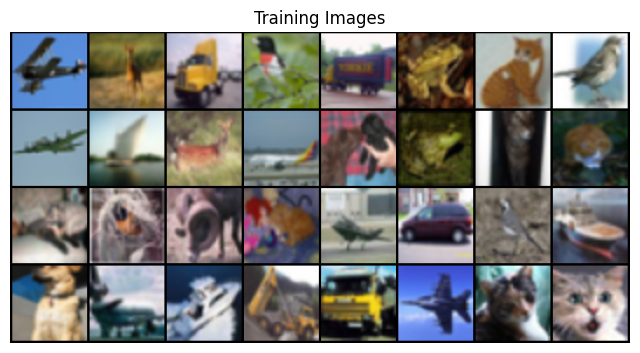

In [6]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [7]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [11]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [12]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [13]:
from skimage.metrics import structural_similarity as ssim
import torch.nn.functional as F

# compute the mean squared error and the ssim score
def compute_mse(x, recon_x):
    x = F.relu(x)
    mse_loss = F.mse_loss(x, recon_x, reduction='sum')
    return mse_loss


def compute_ssim(x, recon_x):
    # Permute to (batch, height, width, channels) for SSIM
    x = x.permute(0, 2, 3, 1)  # Convert to (batch, height, width, channels)
    recon_x = recon_x.permute(0, 2, 3, 1)
    
    # Apply ReLU activation to ensure non-negative values
    x = F.relu(x)
    recon_x = F.relu(recon_x)

    # Calculate SSIM with a specified win_size
    ssim_loss = 1 - ssim(
        x.detach().cpu().numpy(),
        recon_x.detach().cpu().numpy(),
        data_range=1,
        multichannel=True,
        win_size=7,  # Ensure it's an odd number and <= 64
        channel_axis=-1  # Last dimension is channels
    )
    return ssim_loss


In [14]:
# Improved Training and Evaluation Loop with Epoch Loss Calculation

import torch
import torchvision.utils as vutils
from tqdm import tqdm
import time

# Lists to keep track of per-epoch progress (storing only averages)
img_list = []
G_losses = {'train': [], 'eval': []}
D_losses = {'train': [], 'eval': []}
D_accuracies = {'train': [], 'eval': []}
G_ssin_avg = {'train': [], 'eval': []}
G_mse_avg = {'train': [], 'eval': []}
iters = 0

# Start training
print("Starting Training Loop...")
start_time = time.time()
for epoch in range(num_epochs):
    # Track total loss and accuracy for the current epoch
    epoch_G_loss = {'train': 0.0, 'eval': 0.0}
    epoch_D_loss = {'train': 0.0, 'eval': 0.0}
    epoch_D_accuracy = {'train': 0.0, 'eval': 0.0}
    epoch_ssin = {'train': 0.0, 'eval': 0.0}
    epoch_mse = {'train': 0.0, 'eval': 0.0}
    num_batches = {'train': len(train_loader), 'eval': len(val_loader)}

    # Training phase
    netG.train()
    netD.train()
    for i, data in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"), 0):
        
        ############################
        # (1) Update D network
        ###########################
        netD.zero_grad()
        
        # Train with real batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Calculate accuracy for real batch
        real_pred = (output > 0.5).float()
        real_acc = (real_pred == label).float().mean().item()

        # Train with fake batch
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise).detach()  # Generate fake images and detach to free memory
        label.fill_(fake_label)
        output = netD(fake).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        # Calculate accuracy for fake batch
        fake_pred = (output < 0.5).float()
        fake_acc = (fake_pred == label).float().mean().item()
        D_accuracy = (real_acc + fake_acc) / 2

        ############################
        # (2) Update G network
        ###########################
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Accumulate batch losses and accuracy for epoch-level average
        epoch_G_loss['train'] += errG.item()
        epoch_D_loss['train'] += errD.item()
        epoch_D_accuracy['train'] += D_accuracy

        # Calculate SSIM and MSE once per batch to avoid redundant computation
        mse_loss = compute_mse(real_cpu, fake)
        ssim_loss = compute_ssim(real_cpu, fake)
        epoch_mse['train'] += mse_loss
        epoch_ssin['train'] += ssim_loss

        # Save generated images for visualization at intervals
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

    # Calculate average losses and accuracy for the epoch
    avg_G_loss_train = epoch_G_loss['train'] / num_batches['train']
    avg_D_loss_train = epoch_D_loss['train'] / num_batches['train']
    avg_D_acc_train = epoch_D_accuracy['train'] / num_batches['train']
    avg_ssin_train = epoch_ssin['train'] / num_batches['train']
    avg_mse_train = epoch_mse['train'] / num_batches['train']

    # Save the average epoch metrics
    G_losses['train'].append(avg_G_loss_train)
    D_losses['train'].append(avg_D_loss_train)
    D_accuracies['train'].append(avg_D_acc_train)
    G_ssin_avg['train'].append(avg_ssin_train)
    G_mse_avg['train'].append(avg_mse_train)

    # Evaluation phase
    netG.eval()
    netD.eval()
    with torch.no_grad():
        for data in tqdm(val_loader, desc="Evaluation"):
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            output = netD(real_cpu).view(-1)
            errD_real = criterion(output, label)
            D_x = output.mean().item()

            # Accuracy for real batch
            real_pred = (output > 0.5).float()
            real_acc = (real_pred == label).float().mean().item()

            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake = netG(noise)
            label.fill_(fake_label)
            output = netD(fake).view(-1)
            errD_fake = criterion(output, label)
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake

            # Accuracy for fake batch
            fake_pred = (output < 0.5).float()
            fake_acc = (fake_pred == label).float().mean().item()
            D_accuracy = (real_acc + fake_acc) / 2

            label.fill_(real_label)
            output = netD(fake).view(-1)
            errG = criterion(output, label)

            # Accumulate evaluation batch losses and accuracy for epoch-level average
            epoch_G_loss['eval'] += errG.item()
            epoch_D_loss['eval'] += errD.item()
            epoch_D_accuracy['eval'] += D_accuracy

            # Calculate SSIM and MSE for evaluation
            mse_loss = compute_mse(real_cpu, fake)
            ssim_loss = compute_ssim(real_cpu, fake)
            epoch_mse['eval'] += mse_loss
            epoch_ssin['eval'] += ssim_loss

    # Calculate average losses and accuracy for the evaluation phase
    avg_G_loss_eval = epoch_G_loss['eval'] / num_batches['eval']
    avg_D_loss_eval = epoch_D_loss['eval'] / num_batches['eval']
    avg_D_acc_eval = epoch_D_accuracy['eval'] / num_batches['eval']
    avg_ssin_eval = epoch_ssin['eval'] / num_batches['eval']
    avg_mse_eval = epoch_mse['eval'] / num_batches['eval']

    # Save the average evaluation metrics
    G_losses['eval'].append(avg_G_loss_eval)
    D_losses['eval'].append(avg_D_loss_eval)
    D_accuracies['eval'].append(avg_D_acc_eval)
    G_ssin_avg['eval'].append(avg_ssin_eval)
    G_mse_avg['eval'].append(avg_mse_eval)

    # Print statistics for the epoch
    print(f"Epoch [{epoch+1}/{num_epochs}] | "
          f"Train Loss G: {avg_G_loss_train:.4f}, D: {avg_D_loss_train:.4f}, Acc D: {avg_D_acc_train:.4f} | "
          f"Eval Loss G: {avg_G_loss_eval:.4f}, D: {avg_D_loss_eval:.4f}, Acc D: {avg_D_acc_eval:.4f}")
end_time = time.time()
print(f"Training finished in {end_time - start_time:.2f} seconds")


Starting Training Loop...


Evaluation: 100%|██████████| 313/313 [00:14<00:00, 21.38it/s]


Epoch [1/5] | Train Loss G: 12.4467, D: 0.0021, Acc D: 0.5000 | Eval Loss G: 5.2208, D: 0.0089, Acc D: 0.5000


Evaluation: 100%|██████████| 313/313 [00:14<00:00, 21.79it/s]


Epoch [2/5] | Train Loss G: 15.0166, D: 0.0000, Acc D: 0.5000 | Eval Loss G: 5.6441, D: 0.0058, Acc D: 0.5000


Evaluation: 100%|██████████| 313/313 [00:16<00:00, 19.08it/s]


Epoch [3/5] | Train Loss G: 16.2424, D: 0.0000, Acc D: 0.5000 | Eval Loss G: 6.1232, D: 0.0036, Acc D: 0.5000


Evaluation: 100%|██████████| 313/313 [00:14<00:00, 21.30it/s]


Epoch [4/5] | Train Loss G: 17.2234, D: 0.0000, Acc D: 0.5000 | Eval Loss G: 6.1587, D: 0.0035, Acc D: 0.5000


Evaluation: 100%|██████████| 313/313 [00:14<00:00, 20.94it/s]

Epoch [5/5] | Train Loss G: 18.1328, D: 0.0000, Acc D: 0.5000 | Eval Loss G: 7.0280, D: 0.0014, Acc D: 0.5000
Training finished in 479.21 seconds


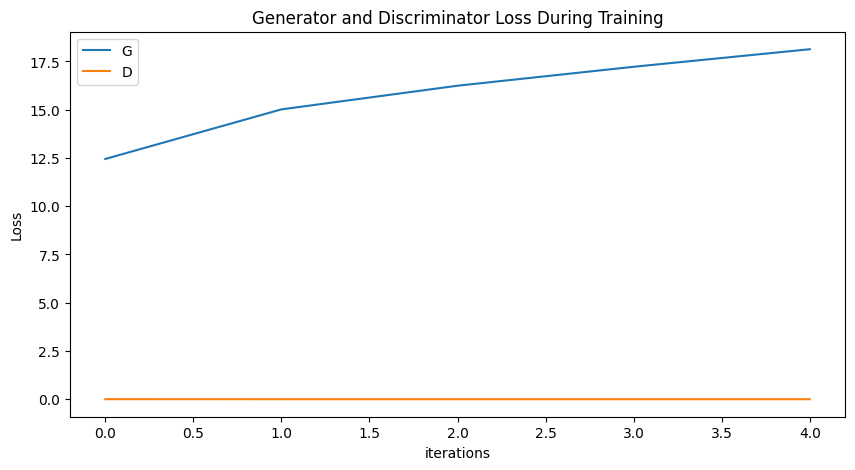

In [15]:
# plot training  losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses['train'],label="G")
plt.plot(D_losses['train'],label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


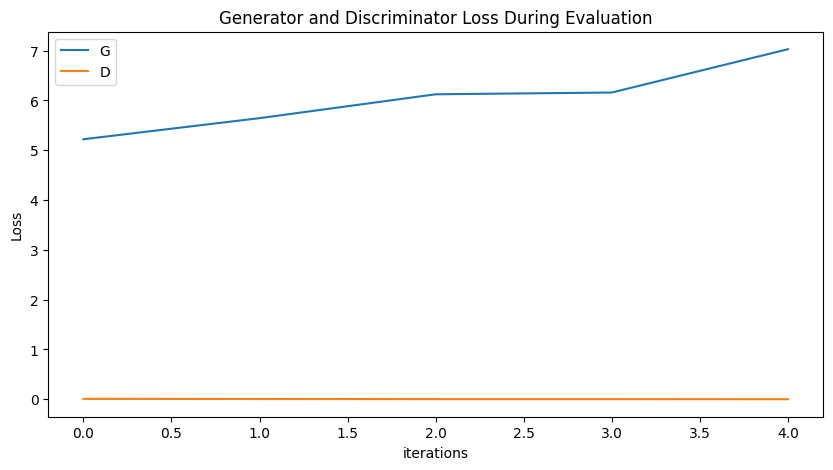

In [16]:
# plot evaluation losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Evaluation")
plt.plot(G_losses['eval'],label="G")
plt.plot(D_losses['eval'],label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


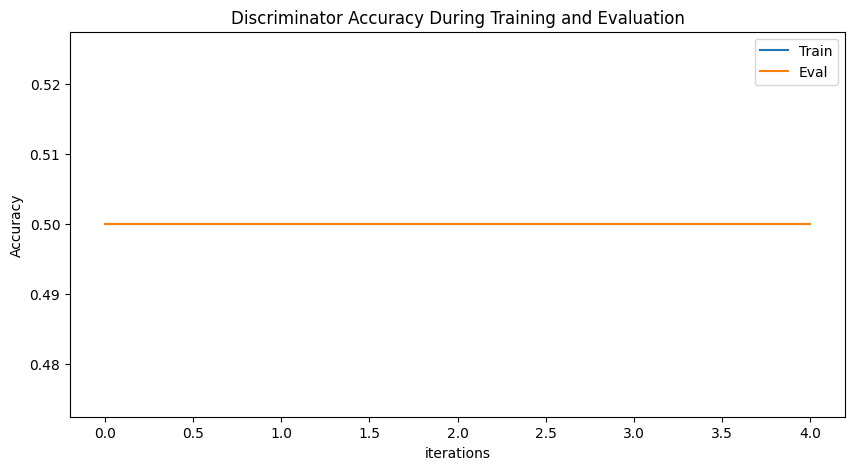

In [17]:
plt.figure(figsize=(10,5))
plt.title("Discriminator Accuracy During Training and Evaluation")
plt.plot(D_accuracies['train'],label="Train")
plt.plot(D_accuracies['eval'],label="Eval")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.show()


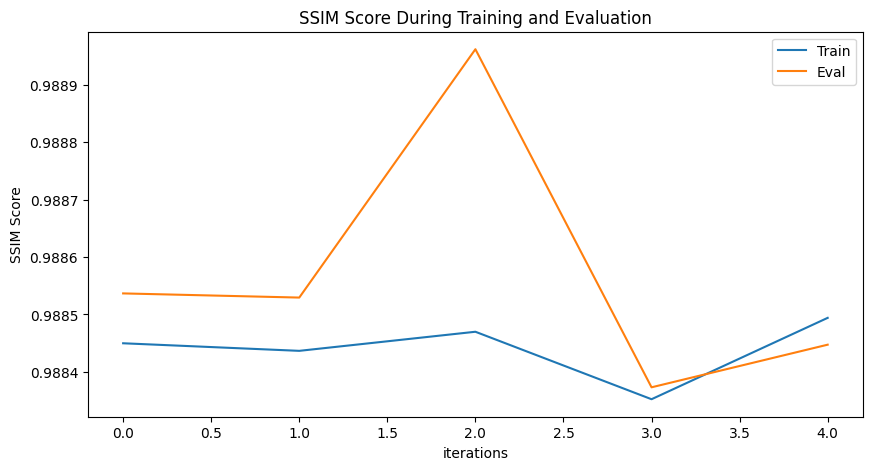

In [18]:
# plot ssim scores
plt.figure(figsize=(10,5))
plt.title("SSIM Score During Training and Evaluation")
plt.plot(G_ssin_avg['train'],label="Train")
plt.plot(G_ssin_avg['eval'],label="Eval")
plt.xlabel("iterations")
plt.ylabel("SSIM Score")
plt.legend()
plt.show()


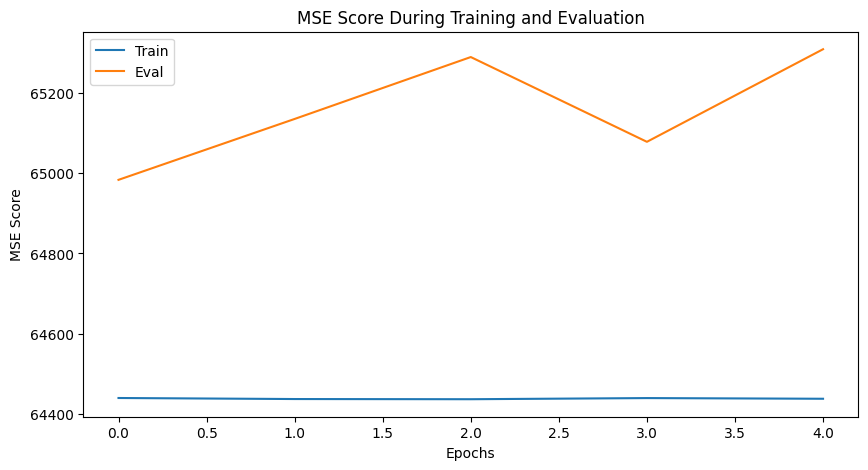

In [19]:
import matplotlib.pyplot as plt

# Move tensors to CPU and convert to numpy for plotting
train_mse = [x.cpu().numpy() if torch.is_tensor(x) else x for x in G_mse_avg['train']]
eval_mse = [x.cpu().numpy() if torch.is_tensor(x) else x for x in G_mse_avg['eval']]

plt.figure(figsize=(10, 5))
plt.title("MSE Score During Training and Evaluation")
plt.plot(train_mse, label="Train")
plt.plot(eval_mse, label="Eval")
plt.xlabel("Epochs")
plt.ylabel("MSE Score")
plt.legend()
plt.show()


Animation size has reached 21575835 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


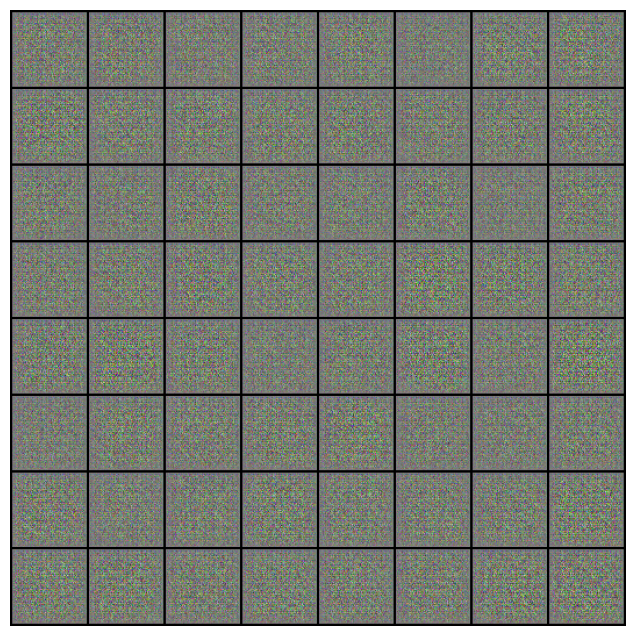

In [20]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


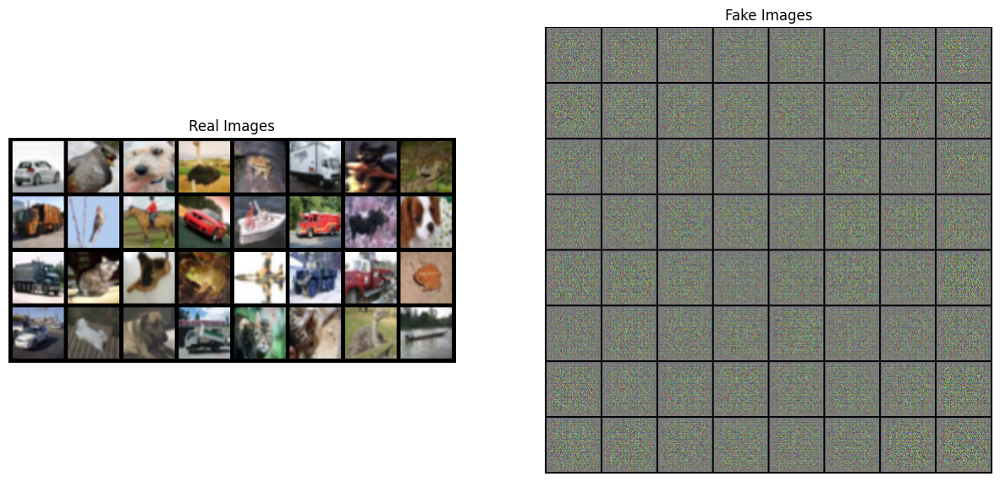

In [21]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()
